In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [41]:
df = pd.read_csv('itineraries_sample_500.csv')

In [42]:
df.columns

Index(['legId', 'searchDate', 'flightDate', 'startingAirport',
       'destinationAirport', 'fareBasisCode', 'travelDuration', 'elapsedDays',
       'isBasicEconomy', 'isRefundable', 'isNonStop', 'baseFare', 'totalFare',
       'seatsRemaining', 'totalTravelDistance',
       'segmentsDepartureTimeEpochSeconds', 'segmentsDepartureTimeRaw',
       'segmentsArrivalTimeEpochSeconds', 'segmentsArrivalTimeRaw',
       'segmentsArrivalAirportCode', 'segmentsDepartureAirportCode',
       'segmentsAirlineName', 'segmentsAirlineCode',
       'segmentsEquipmentDescription', 'segmentsDurationInSeconds',
       'segmentsDistance', 'segmentsCabinCode', 'strata'],
      dtype='object')

In [43]:
df['day_to_dep'] = pd.to_datetime(df['flightDate']) - pd.to_datetime(df['searchDate'])
df['day_to_dep'].head(50)

0     2 days
1     9 days
2     5 days
3     1 days
4     4 days
5     5 days
6     8 days
7     6 days
8     3 days
9    12 days
10    8 days
11   11 days
12    4 days
13    8 days
14   11 days
15    2 days
16    7 days
17    5 days
18    7 days
19   10 days
20    5 days
21    2 days
22    6 days
23   11 days
24    4 days
25    4 days
26    1 days
27    7 days
28    3 days
29    1 days
30    4 days
31    8 days
32    4 days
33    1 days
34    1 days
35    7 days
36    8 days
37    6 days
38    3 days
39    3 days
40    4 days
41   10 days
42   10 days
43    1 days
44    1 days
45    1 days
46   10 days
47    1 days
48    7 days
49    1 days
Name: day_to_dep, dtype: timedelta64[ns]

In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500001 entries, 0 to 500000
Data columns (total 29 columns):
 #   Column                             Non-Null Count   Dtype          
---  ------                             --------------   -----          
 0   legId                              500001 non-null  object         
 1   searchDate                         500001 non-null  object         
 2   flightDate                         500001 non-null  object         
 3   startingAirport                    500001 non-null  object         
 4   destinationAirport                 500001 non-null  object         
 5   fareBasisCode                      500001 non-null  object         
 6   travelDuration                     500001 non-null  object         
 7   elapsedDays                        500001 non-null  int64          
 8   isBasicEconomy                     500001 non-null  bool           
 9   isRefundable                       500001 non-null  bool           
 10  isNonSto

In [45]:
top_departure_locations = df['startingAirport'].value_counts().head(10)
print(top_departure_locations)

startingAirport
LAX    48959
LGA    36075
BOS    35558
SFO    34785
DFW    34176
CLT    33588
ORD    33284
ATL    32510
MIA    30226
PHL    28880
Name: count, dtype: int64


In [46]:
# Group by startingAirport, destinationAirport, and flightDate, and count the number of flights
top_flights = df.groupby(['startingAirport', 'destinationAirport', 'flightDate']).size().reset_index(name='flight_count')

# Sort by flight_count in descending order and get the top 10
top_flights = top_flights.sort_values(by='flight_count', ascending=False).head(10)

print(top_flights)

      startingAirport destinationAirport  flightDate  flight_count
32769             LGA                ORD  2022-09-13            47
1796              ATL                LAX  2022-08-30            47
27642             LAX                BOS  2022-08-21            46
32140             LGA                LAX  2022-09-21            44
29372             LAX                LGA  2022-09-13            44
29367             LAX                LGA  2022-09-08            44
27421             LAX                ATL  2022-08-12            44
29971             LAX                ORD  2022-08-09            43
1806              ATL                LAX  2022-09-09            43
30002             LAX                ORD  2022-09-09            42


In [47]:
import pandas as pd

# Group the dataframe by departure airport, arrival airport, and departure date
grouped = df.groupby(['startingAirport', 'destinationAirport', 'flightDate'])

# Extract unique flight identifiers
unique_flights = list(grouped.groups.keys())  # List of (start_airport, dest_airport, dep_date) tuples

# Select 10 unique flights
selected_flights = unique_flights[:10]  # Modify this if you want a random selection

# Dictionary to store individual flight DataFrames
flight_price_changes = {}

# Iterate through selected flights
for flight in selected_flights:
    start_airport, dest_airport, dep_date = flight
    
    # Get the corresponding DataFrame
    flight_df = grouped.get_group(flight).copy()
    
    # Sort by days to departure
    flight_df = flight_df.sort_values(by='day_to_dep')
    
    # Store in dictionary
    flight_price_changes[flight] = flight_df

# Print sample of one flight's data
print(flight_price_changes[selected_flights[0]].head())


                                 legId  searchDate  flightDate  \
1596  daf9979d3292296fad725eed834ef76a  2022-04-17  2022-04-18   

     startingAirport destinationAirport fareBasisCode travelDuration  \
1596             ATL                BOS       D01PXP5       PT10H20M   

      elapsedDays  isBasicEconomy  isRefundable  ...  \
1596            1           False         False  ...   

      segmentsArrivalAirportCode  segmentsDepartureAirportCode  \
1596                    MCO||BOS                      ATL||MCO   

                       segmentsAirlineName  segmentsAirlineCode  \
1596  Frontier Airlines||Frontier Airlines               F9||F9   

      segmentsEquipmentDescription segmentsDurationInSeconds segmentsDistance  \
1596                            ||               6060||10620        399||1119   

     segmentsCabinCode   strata day_to_dep  
1596      coach||coach  2022-04     1 days  

[1 rows x 29 columns]


In [49]:
flight_price_changes

{('ATL',
  'BOS',
  '2022-04-18'):                                  legId  searchDate  flightDate  \
 1596  daf9979d3292296fad725eed834ef76a  2022-04-17  2022-04-18   
 
      startingAirport destinationAirport fareBasisCode travelDuration  \
 1596             ATL                BOS       D01PXP5       PT10H20M   
 
       elapsedDays  isBasicEconomy  isRefundable  ...  \
 1596            1           False         False  ...   
 
       segmentsArrivalAirportCode  segmentsDepartureAirportCode  \
 1596                    MCO||BOS                      ATL||MCO   
 
                        segmentsAirlineName  segmentsAirlineCode  \
 1596  Frontier Airlines||Frontier Airlines               F9||F9   
 
       segmentsEquipmentDescription segmentsDurationInSeconds segmentsDistance  \
 1596                            ||               6060||10620        399||1119   
 
      segmentsCabinCode   strata day_to_dep  
 1596      coach||coach  2022-04     1 days  
 
 [1 rows x 29 columns],
 ('ATL',

In [50]:
for flight, flight_df in flight_price_changes.items():
    print(flight_df.head())

                                 legId  searchDate  flightDate  \
1596  daf9979d3292296fad725eed834ef76a  2022-04-17  2022-04-18   

     startingAirport destinationAirport fareBasisCode travelDuration  \
1596             ATL                BOS       D01PXP5       PT10H20M   

      elapsedDays  isBasicEconomy  isRefundable  ...  \
1596            1           False         False  ...   

      segmentsArrivalAirportCode  segmentsDepartureAirportCode  \
1596                    MCO||BOS                      ATL||MCO   

                       segmentsAirlineName  segmentsAirlineCode  \
1596  Frontier Airlines||Frontier Airlines               F9||F9   

      segmentsEquipmentDescription segmentsDurationInSeconds segmentsDistance  \
1596                            ||               6060||10620        399||1119   

     segmentsCabinCode   strata day_to_dep  
1596      coach||coach  2022-04     1 days  

[1 rows x 29 columns]
                                 legId  searchDate  flightDate  \

In [99]:
import pandas as pd

# Group the dataframe by departure airport, arrival airport, and departure date
grouped = df.groupby(['startingAirport', 'destinationAirport', 'flightDate'])

# Extract unique flight identifiers
unique_flights = list(grouped.groups.keys())  # List of (start_airport, dest_airport, dep_date) tuples

# Select 10 unique flights
selected_flights = unique_flights[-2010:-2000]  # Modify this if you want a random selection

# List to store DataFrames
flight_price_changes_nongroupped = []

# Iterate through selected flights
for flight in selected_flights:
    start_airport, dest_airport, dep_date = flight
    
    # Get the corresponding DataFrame
    flight_df = grouped.get_group(flight).copy()
    
    # Sort by days to departure
    flight_df = flight_df.sort_values(by='day_to_dep')
    
    # Append to list
    flight_price_changes_nongroupped.append(flight_df)

# Print the first few rows of each DataFrame in the list
for i, flight_df in enumerate(flight_price_changes_nongroupped):
    print(f"Flight {i+1}:")
    print(flight_df.head(), "\n")

Flight 1:
                                 legId  searchDate  flightDate  \
1596  daf9979d3292296fad725eed834ef76a  2022-04-17  2022-04-18   

     startingAirport destinationAirport fareBasisCode travelDuration  \
1596             ATL                BOS       D01PXP5       PT10H20M   

      elapsedDays  isBasicEconomy  isRefundable  ...  \
1596            1           False         False  ...   

      segmentsArrivalAirportCode  segmentsDepartureAirportCode  \
1596                    MCO||BOS                      ATL||MCO   

                       segmentsAirlineName  segmentsAirlineCode  \
1596  Frontier Airlines||Frontier Airlines               F9||F9   

      segmentsEquipmentDescription segmentsDurationInSeconds segmentsDistance  \
1596                            ||               6060||10620        399||1119   

     segmentsCabinCode   strata day_to_dep  
1596      coach||coach  2022-04     1 days  

[1 rows x 29 columns] 

Flight 2:
                                 legId  sea

KeyboardInterrupt: 

In [102]:
def count_consecutive_prices(df, price_column='totalFare'):
    # Create a boolean series indicating where the price changes
    price_change = df[price_column].diff().ne(0)
    
    # Use cumsum to create a group identifier for consecutive prices
    groups = price_change.cumsum()
    
    # Group by the group identifier and count the size of each group
    consecutive_counts = df.groupby(groups).size()
    
    return consecutive_counts

# Apply the function to each DataFrame in the list
consecutive_price_counts = [count_consecutive_prices(flight_df) for flight_df in flight_price_changes_nongroupped]

# Print the results for the first DataFrame as an example
print(sum(consecutive_price_counts)/len(consecutive_price_counts))

totalFare
1     1.081939
2          NaN
3          NaN
4          NaN
5          NaN
6          NaN
7          NaN
8          NaN
9          NaN
10         NaN
11         NaN
12         NaN
13         NaN
14         NaN
15         NaN
16         NaN
17         NaN
18         NaN
19         NaN
20         NaN
21         NaN
22         NaN
23         NaN
24         NaN
25         NaN
26         NaN
27         NaN
28         NaN
29         NaN
30         NaN
31         NaN
32         NaN
33         NaN
34         NaN
35         NaN
36         NaN
37         NaN
38         NaN
39         NaN
40         NaN
41         NaN
42         NaN
43         NaN
44         NaN
45         NaN
46         NaN
dtype: float64


In [ ]:
I have a list of DataFrames, flight_price_changes_nongroupped, where each DataFrame cor

In [96]:
flight_price_changes_nongroupped[0]

flight_price_changes_nongroupped[0].columns

Index(['legId', 'searchDate', 'flightDate', 'startingAirport',
       'destinationAirport', 'fareBasisCode', 'travelDuration', 'elapsedDays',
       'isBasicEconomy', 'isRefundable', 'isNonStop', 'baseFare', 'totalFare',
       'seatsRemaining', 'totalTravelDistance',
       'segmentsDepartureTimeEpochSeconds', 'segmentsDepartureTimeRaw',
       'segmentsArrivalTimeEpochSeconds', 'segmentsArrivalTimeRaw',
       'segmentsArrivalAirportCode', 'segmentsDepartureAirportCode',
       'segmentsAirlineName', 'segmentsAirlineCode',
       'segmentsEquipmentDescription', 'segmentsDurationInSeconds',
       'segmentsDistance', 'segmentsCabinCode', 'strata', 'day_to_dep'],
      dtype='object')

In [98]:
# Select the specific columns
columns_to_display = [
    'totalFare', 'startingAirport', 'destinationAirport', 
    'segmentsArrivalAirportCode', 'segmentsDepartureAirportCode', 
    'flightDate', 'searchDate', 'segmentsAirlineName'
]

# Display the selected columns for the first dataframe in flight_price_changes_nongroupped
flight_price_changes_nongroupped[0][columns_to_display]

,totalFare,startingAirport,destinationAirport,segmentsArrivalAirportCode,segmentsDepartureAirportCode,flightDate,searchDate,segmentsAirlineName
137928,687.60,SFO,DTW,SEA||DTW,SFO||SEA,2022-07-14,2022-07-12,Delta||Delta
154389,538.60,SFO,DTW,SEA||DTW,SFO||SEA,2022-07-14,2022-07-08,Alaska Airlines||Alaska Airlines
169024,607.20,SFO,DTW,LAX||DTW,SFO||LAX,2022-07-14,2022-07-07,Delta||Delta
142513,518.59,SFO,DTW,DTW,SFO,2022-07-14,2022-07-01,Delta
199872,514.00,SFO,DTW,DEN||DTW,SFO||DEN,2022-07-14,2022-07-01,Frontier Airlines||Frontier Airlines
148374,647.19,SFO,DTW,ATL||DTW,SFO||ATL,2022-07-14,2022-06-26,Delta||Delta
158538,638.60,SFO,DTW,ORD||DTW,SFO||ORD,2022-07-14,2022-06-25,Alaska Airlines||Alaska Airlines
133233,514.00,SFO,DTW,DEN||DTW,SFO||DEN,2022-07-14,2022-06-16,Frontier Airlines||Frontier Airlines
152599,514.00,SFO,DTW,DEN||DTW,SFO||DEN,2022-07-14,2022-06-15,Frontier Airlines||Frontier Airlines


In [77]:
import pandas as pd

# Group the dataframe by departure airport, arrival airport, and departure date
grouped = df.groupby(['startingAirport', 'destinationAirport'])

# Extract unique flight identifiers
unique_flights = list(grouped.groups.keys())  # List of (start_airport, dest_airport, dep_date) tuples

# Select 10 unique flights
selected_flights = unique_flights[:10]  # Modify this if you want a random selection

# List to store DataFrames
flight_price_changes = []

# Iterate through selected flights
for flight in selected_flights:
    # start_airport, dest_airport, dep_date = flight
    start_airport, dest_airport = flight
    
    # Get the corresponding DataFrame
    flight_df = grouped.get_group(flight).copy()
    
    # Sort by days to departure
    flight_df = flight_df.sort_values(by='day_to_dep')
    
    # Append to list
    flight_price_changes.append(flight_df)

# Print the first few rows of each DataFrame in the list
for i, flight_df in enumerate(flight_price_changes):
    print(f"Flight {i+1}:")
    print(flight_df.head(), "\n")


Flight 1:
                                   legId  searchDate  flightDate  \
265868  1b24e4d54f7c8d28063d298ed47e23f2  2022-08-04  2022-08-05   
372668  ce88de3ce7239c38c6dcfb0dc604ce7a  2022-09-09  2022-09-10   
380736  d17b007cc10e1369c8c784a50e74d956  2022-09-09  2022-09-10   
212001  e3e40b3b6af11d461414937372dc7366  2022-08-29  2022-08-30   
199297  4fbd160789722372f5d3c4c6da7e6cc9  2022-07-25  2022-07-26   

       startingAirport destinationAirport fareBasisCode travelDuration  \
265868             ATL                BOS      G0AIZNN1        PT6H59M   
372668             ATL                BOS      KA0NX0MC        PT2H36M   
380736             ATL                BOS      G0AJZNN1        PT6H52M   
212001             ATL                BOS      UA0NX0MQ       PT10H33M   
199297             ATL                BOS      G0AIZNN1        PT4H39M   

        elapsedDays  isBasicEconomy  isRefundable  ...  \
265868            0           False         False  ...   
372668            0 

In [79]:
flight_price_changes[6]

,legId,searchDate,flightDate,startingAirport,destinationAirport,fareBasisCode,travelDuration,elapsedDays,isBasicEconomy,isRefundable,...,segmentsArrivalAirportCode,segmentsDepartureAirportCode,segmentsAirlineName,segmentsAirlineCode,segmentsEquipmentDescription,segmentsDurationInSeconds,segmentsDistance,segmentsCabinCode,strata,day_to_dep
681,9161351438c9606bbed65fcaa6866ff8,2022-04-22,2022-04-23,ATL,IAD,L0AIZNN1,PT5H52M,0,False,False,...,CLT||IAD,ATL||CLT,American Airlines||American Airlines,AA||AA,Canadair Regional Jet 900||Canadair Regional J...,5160||5040,228||327,coach||coach,2022-04,1 days
44517,434876a5ef284c89ef40a53724cf99a6,2022-05-30,2022-05-31,ATL,IAD,UAA0OKEN,PT7H22M,0,False,False,...,ORD||IAD,ATL||ORD,United||United,UA||UA,Embraer 175 (Enhanced Winglets)||Boeing 757-200,7980||6720,600||594,coach||coach,2022-05,1 days
45957,2d79f51258ea472e0dfa2bca4fddf8c4,2022-05-18,2022-05-19,ATL,IAD,V0AHZNN1,PT6H17M,0,False,False,...,CLT||IAD,ATL||CLT,American Airlines||American Airlines,AA||AA,Airbus A320||Canadair Regional Jet 900,4680||5640,228||327,coach||coach,2022-05,1 days
47089,c001fa662635f03b73889e3a9bd94b30,2022-05-08,2022-05-09,ATL,IAD,QAA0OKEN,PT6H41M,1,False,False,...,ORD||IAD,ATL||ORD,United||United,UA||UA,Airbus A319||Boeing 757-200,7200||6720,600||594,coach||coach,2022-05,1 days
47193,d985f367f3de0b48aca9c2c564aa890a,2022-05-07,2022-05-08,ATL,IAD,V0AHZNN1,PT3H50M,0,False,False,...,CLT||IAD,ATL||CLT,American Airlines||American Airlines,AA||AA,Airbus A319||Canadair Regional Jet 900,4860||5640,228||327,coach||coach,2022-05,1 days
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
327886,cc5f018aa13b0bc5a09838b8c05e1132,2022-07-16,2022-09-14,ATL,IAD,TAVTA5BC,PT1H40M,1,True,False,...,IAD,ATL,Delta,DL,Boeing 717,6000,541,coach,2022-09,60 days
331822,058331e9324c5093679213c4ec188517,2022-07-09,2022-09-07,ATL,IAD,QVAHZNN3,PT3H48M,0,False,False,...,CLT||IAD,ATL||CLT,American Airlines||American Airlines,AA||AA,Airbus A320||Airbus A319,4560||4620,228||327,coach||coach,2022-09,60 days
347245,e7a02f568d52c5c1719bf12fcb27b72a,2022-07-10,2022-09-08,ATL,IAD,V0AHZNN1,PT8H19M,0,False,False,...,DFW||IAD,ATL||DFW,American Airlines||American Airlines,AA||AA,Boeing 737-800||Boeing 737-800,8760||10260,725||1177,coach||coach,2022-09,60 days
406141,c85c7fe3f251d1c5cae36e6f7a30266c,2022-07-16,2022-09-14,ATL,IAD,NVAIKSN1,PT3H34M,0,False,False,...,CLT||IAD,ATL||CLT,American Airlines||American Airlines,AA||AA,Canadair Regional Jet 900||Canadair Regional J...,5160||4980,228||327,coach||coach,2022-09,60 days


In [88]:
flight_price_changes[6]['totalFare']

681       266.10
44517     327.60
45957     210.10
47089     237.60
47193     210.10
           ...  
327886    138.60
331822    148.10
347245    287.60
406141    176.11
293086    128.60
Name: totalFare, Length: 898, dtype: float64

In [84]:
grouped_flight_price_changes = []

for flight_df in flight_price_changes:
    grouped_df = flight_df.groupby('day_to_dep')['totalfare'].mean()
    grouped_flight_price_changes.append(grouped_df)

grouped_flight_price_changes[6]

KeyError: 'Column not found: totalfare'

In [6]:
# Grouping by date of departure and getting the mean price
daily_avg_prices = df.groupby('flightDate')['totalFare'].agg([
    ('average_price', 'mean'),
    ('count', 'count')  
]).round(2)

daily_avg_prices = daily_avg_prices.sort_index()

print(daily_avg_prices.head())

            average_price  count
flightDate                      
2022-04-17         423.79     57
2022-04-18         435.74    102
2022-04-19         328.57    195
2022-04-20         326.95    244
2022-04-21         382.59    256


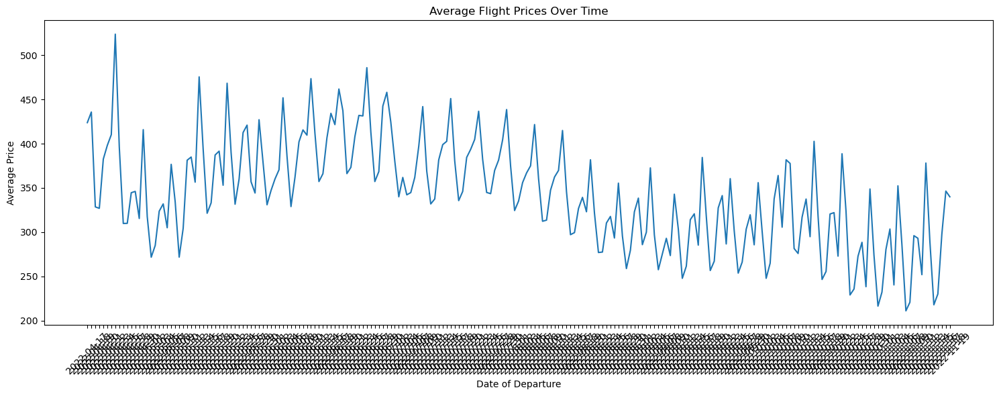

In [7]:
plt.figure(figsize=(15, 6))
plt.plot(daily_avg_prices.index, daily_avg_prices['average_price'])
plt.title('Average Flight Prices Over Time')
plt.xlabel('Date of Departure')
plt.ylabel('Average Price')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

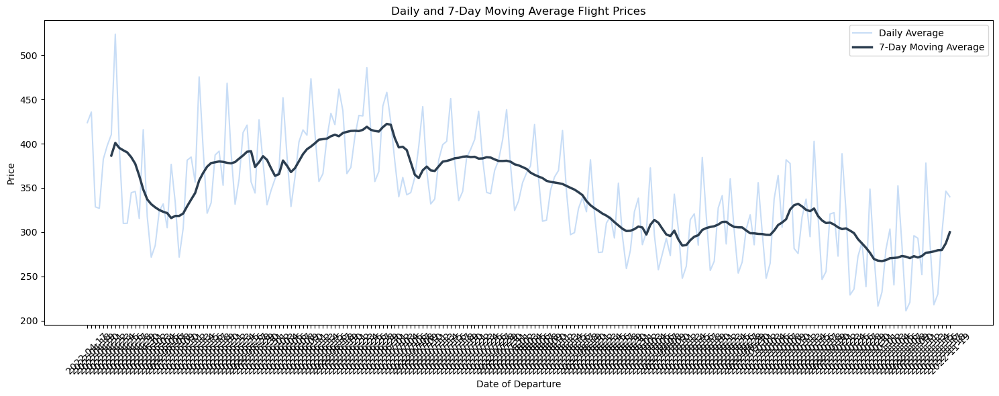

In [14]:
# 7-day rolling average
daily_avg_prices['7_day_avg'] = daily_avg_prices['average_price'].rolling(window=7).mean()

# Create a new figure and axis
fig, ax = plt.subplots(figsize=(15, 6))

# Daily prices (lighter) and rolling average (darker)
ax.plot(daily_avg_prices.index, daily_avg_prices['average_price'], 
        alpha=0.3, color='#4a90e2', label='Daily Average')
ax.plot(daily_avg_prices.index, daily_avg_prices['7_day_avg'], 
        linewidth=2.5, color='#2c3e50', label='7-Day Moving Average')

# Add title and labels
ax.set_title('Daily and 7-Day Moving Average Flight Prices')
ax.set_xlabel('Date of Departure')
ax.set_ylabel('Price')
ax.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [16]:
price_table = df.groupby('flightDate').agg({
    'totalFare': [
        ('Average Price', 'mean'),
        ('Minimum Price', 'min'),
        ('Maximum Price', 'max'),
        ('Number of Flights', 'count')
    ]
}).round(2)

price_table.columns = price_table.columns.get_level_values(1)

price_table = price_table.reset_index()

for col in ['Average Price', 'Minimum Price', 'Maximum Price']:
    price_table[col] = price_table[col].apply(lambda x: f'${x:,.2f}')

price_table['flightDate'] = pd.to_datetime(price_table['flightDate']).dt.strftime('%Y-%m-%d')

price_table = price_table.sort_values('flightDate')


print("\nFirst few rows of the price table:")
print(price_table.head())



First few rows of the price table:
   flightDate Average Price Minimum Price Maximum Price  Number of Flights
0  2022-04-17       $423.79        $82.61     $2,220.60                 57
1  2022-04-18       $435.74        $91.61     $1,955.10                102
2  2022-04-19       $328.57        $81.59     $1,732.59                195
3  2022-04-20       $326.95       $101.60       $794.10                244
4  2022-04-21       $382.59        $78.60     $1,956.10                256


In [5]:
# Print the whole table
price_table.head(50)

NameError: name 'price_table' is not defined